In [ ]:
#!pip install -q kaggle
#!mkdir -p ~/.kaggle
#!cp kaggle.json ~/.kaggle/
#!ls ~/.kaggle
#!chmod 600 /root/.kaggle/kaggle.json  # set permission

In [ ]:
#!rm *.dcm
#!rm *.txt
#!rm *.zip
#!rm *.csv
#!rm *.json

In [ ]:
# install dependencies not included by Colab
# use pip3 to ensure compatibility w/ Google Deep Learning Images 
!pip3 install -q pydicom 
!pip3 install -q tqdm 
!pip3 install -q imgaug 

     |████████████████████████████████| 1.9MB 5.6MB/s 


# 1 Setup and Load

In [ ]:
#packages for setup and prepratory
import os
from google.colab import drive, files

In [ ]:
#Set root directory of the project
ROOT_DIR        = os.path.abspath(os.getcwd())

if not os.path.exists(ROOT_DIR):
    os.makedirs(ROOT_DIR)
os.chdir(ROOT_DIR)

#Set directory to save LOGS
MODEL_DIR       = os.path.join(ROOT_DIR, 'logs')

if not os.path.exists(MODEL_DIR):
    os.makedirs(MODEL_DIR)

#Set directory to save SCREENSHOTS
SCREENSHOTS_DIR = os.path.join(ROOT_DIR, 'screenshots')

if not os.path.exists(SCREENSHOTS_DIR):
    os.makedirs(SCREENSHOTS_DIR)


In [ ]:
ROOT_DIR

'/content'

In [ ]:
files.upload()  #this will prompt you to upload the kaggle.json

Saving kaggle.json to kaggle.json


{'kaggle.json': b'{"username":"dineshningoo","key":"739a443fce0974446672f27b717cb7d1"}'}

In [ ]:
#Configuration environment to access KAGGLE Account
os.environ['KAGGLE_USERNAME']="dineshningoo"
os.environ['KAGGLE_KEY']="739a443fce0974446672f27b717cb7d1"

In [ ]:
# install most recent version of kaggle API not included by Colab
!pip uninstall -y kaggle
!pip install --upgrade pip
!pip install kaggle==1.5.6
!kaggle -v

Uninstalling kaggle-1.5.10:
  Successfully uninstalled kaggle-1.5.10
     |████████████████████████████████| 1.5MB 4.2MB/s 
  Found existing installation: pip 19.3.1
    Uninstalling pip-19.3.1:
      Successfully uninstalled pip-19.3.1
     |████████████████████████████████| 58 kB 2.7 MB/s 
  Created wheel for kaggle: filename=kaggle-1.5.6-py3-none-any.whl size=72859 sha256=a6e42ed5cb2a9e5677dd7a9285cd3de7e32cfbbd9c96b3c3583a9eb8c04bb2bf
  Stored in directory: /root/.cache/pip/wheels/aa/e7/e7/eb3c3d514c33294d77ddd5a856bdd58dc9c1fabbed59a02a2b
Successfully built kaggle
Kaggle API 1.5.6


## 1.1 Importing Necessary Libraries

In [ ]:
%tensorflow_version 2.x
import tensorflow
tensorflow.__version__

'2.4.1'

In [ ]:
#basic python
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

#computer vison pakages
import cv2
import glob
from PIL import Image
import pydicom
import pydicom as dcm
import pylab

#convolution packages
import tensorflow as tf
from tensorflow.keras.layers import Conv2D, Activation, BatchNormalization
from tensorflow.keras.layers import UpSampling2D, Input, Concatenate, Reshape

#model package
from tensorflow.keras.models import Model

#mobilenet packages
from tensorflow.keras.applications.mobilenet import MobileNet
from tensorflow.keras.applications.mobilenet import preprocess_input

#packages for model compliation
from tensorflow.keras.optimizers import Adam #optimizers
from tensorflow.keras.losses import binary_crossentropy #losses

#packages for model fitting
from tensorflow.keras.callbacks import ModelCheckpoint, EarlyStopping, ReduceLROnPlateau

#other support packages
import os
from os.path import isfile, join
import random
import warnings

## 1.2 Initialize: Parameters and Hyperparameters

### 1.2.1 Parameters

In [ ]:
# Initialize the random number generator
random.seed(0)
tf.random.set_seed(0)

#Suppress display of warnings
warnings.simplefilter('ignore')

In [ ]:
TRAIN_IMAGES_DIR   =  os.path.join(ROOT_DIR, 'stage_2_train_images')
TEST_IMAGES_DIR    =  os.path.join(ROOT_DIR, 'stage_2_test_images')

In [ ]:
# Images Example
TRAIN_IMAGES       = [f for f in os.listdir(TRAIN_IMAGES_DIR) if isfile(join(TRAIN_IMAGES_DIR, f))]
TEST_IMAGES        = [f for f in os.listdir(TEST_IMAGES_DIR) if isfile(join(TEST_IMAGES_DIR, f))]

In [ ]:
print('5 Training images', TRAIN_IMAGES[:5]) # Print the first 5

5 Training images ['c9299322-1d78-4d83-8f7c-45487ff01cc2.dcm', '0ca9d557-c26c-4dfc-84cc-aac7254ceeb1.dcm', '37f70057-7e01-4aae-8940-6712bfe34255.dcm', 'f060ad29-440c-4662-ad71-e69516a3c42e.dcm', '9f00ee9d-2d51-4ff2-845c-583904f36fd1.dcm']


### 1.2.2 Hyperparameters

In [ ]:
#hyperparameters FOR IMAGE / FEATURE CREATION
#lets initialize height and width values as 1024 * 1024 as we intend to use MobileNet having 1024 * 1024 sized INPUT IMAGES / FEATURES 
IMAGE_HEIGHT   = 1024
IMAGE_WIDTH    = 1024
IMAGE_SIZE     = 1024

#hyperparameters FOR MASK / LABEL CREATION
#lets initialize height and width values as 1024 * 1024 as we inted to use UNET architecture coupled with MOBILENET having 1024 * 1024 sized OUTPUT MASKS / LABELS
MASK_HEIGHT    = 1024
MASK_WIDTH     = 1024
MASK_SIZE      = 1024

#hyperparameters for model compilation
#we can have width hyper parameter as 0.25, 0.5, 0.75 or 1.0
#higher width increases accuracy as well as increases latency
ALPHA          = 1

#hyperparameters for model fitting
BATCH          = 1
EPOCHS         = 10
FIT            = False

## 1.3  Load Dataset

### 1.3.1 Import Dataset From Kaggle

In [ ]:
#import dataset
!kaggle competitions download -c rsna-pneumonia-detection-challenge

100% 3.66G/3.66G [00:44<00:00, 50.0MB/s]
100% 3.66G/3.66G [00:45<00:00, 87.3MB/s]


In [ ]:
#unzip dataset
!unzip -q -o rsna-pneumonia-detection-challenge.zip

In [ ]:
!ls \

'GCP Credits Request Link - RSNA.txt'	  stage_2_sample_submission.csv
 kaggle.json				  stage_2_test_images
 rsna-pneumonia-detection-challenge.zip   stage_2_train_images
 sample_data				  stage_2_train_labels.csv
 stage_2_detailed_class_info.csv


In [ ]:
!rm 'GCP Credits Request Link - RSNA.txt'
!rm 'rsna-pneumonia-detection-challenge.zip'

### 1.3.2 CSV Files

#### 1.3.2.1 CSV Files: Read

In [ ]:
#open file as read only
#data = np.load('/content/drive/My Drive/Colab Notebooks/images.npy', allow_pickle=True)

In [ ]:
detail_class_info    = pd.read_csv('stage_2_detailed_class_info.csv')
train_label          = pd.read_csv('stage_2_train_labels.csv')
samp_submission      = pd.read_csv('stage_2_sample_submission.csv')

#### 1.3.2.2 CSV Files: Verify

In [ ]:
#Viewing the dataset on a high level-detailed class info file
detail_class_info.head()

,patientId,class
0,0004cfab-14fd-4e49-80ba-63a80b6bddd6,No Lung Opacity / Not Normal
1,00313ee0-9eaa-42f4-b0ab-c148ed3241cd,No Lung Opacity / Not Normal
2,00322d4d-1c29-4943-afc9-b6754be640eb,No Lung Opacity / Not Normal
3,003d8fa0-6bf1-40ed-b54c-ac657f8495c5,Normal
4,00436515-870c-4b36-a041-de91049b9ab4,Lung Opacity


In [ ]:
#Viewing the dataset on a high level-train_labels info file
train_label.head()

,patientId,x,y,width,height,Target
0,0004cfab-14fd-4e49-80ba-63a80b6bddd6,NaN,NaN,NaN,NaN,0
1,00313ee0-9eaa-42f4-b0ab-c148ed3241cd,NaN,NaN,NaN,NaN,0
2,00322d4d-1c29-4943-afc9-b6754be640eb,NaN,NaN,NaN,NaN,0
3,003d8fa0-6bf1-40ed-b54c-ac657f8495c5,NaN,NaN,NaN,NaN,0
4,00436515-870c-4b36-a041-de91049b9ab4,264.0,152.0,213.0,379.0,1


In [ ]:
#Viewing the dataset on a high level-sample submission file
samp_submission.head()

,patientId,PredictionString
0,0000a175-0e68-4ca4-b1af-167204a7e0bc,0.5 0 0 100 100
1,0005d3cc-3c3f-40b9-93c3-46231c3eb813,0.5 0 0 100 100
2,000686d7-f4fc-448d-97a0-44fa9c5d3aa6,0.5 0 0 100 100
3,000e3a7d-c0ca-4349-bb26-5af2d8993c3d,0.5 0 0 100 100
4,00100a24-854d-423d-a092-edcf6179e061,0.5 0 0 100 100


All chest examinations withTarget = 1 (pathology detected) associated with class: Lung Opacity.

The chest examinations with Target = 0 (no pathology detected) are either of class: Normal or class: No Lung Opacity / Not Normal.

Detected Lung Opacity window
For the class Lung Opacity, corresponding to values of Target = 1, we plot the density of x, y, width and height.

#### 1.3.2.3 CSV Files: Observation Summary

Relating observations in "detailed_class_info.csv" and "train_labels.csv" files

We are able to deduce that:

WHEN a perticular patient ID in "detailed_class_info.csv" is classified as having "No Lung Opacity / Not Normal" or "Normal". The same patient ID in "train_labels.csv"
1. Does not have bounding box details
2. target is confirmed as 0 i.e. has PNEUMONIA

AND WHEN a perticular patient ID in "detailed_class_info.csv" is classified as having "Lung Opacity". The same patient ID in "train_labels.csv"
1. Provides bounding box details where opacity is observed
2. target is confirmed as 1 i.e. has PNEUMONIA

### 1.3.3 DICOM Files

Medical images are stored in a special format known as DICOM files (*.dcm). They contain a combination of header metadata as well as a raw image arrays for pixel data. We will use a library called pydicom to read the files. This file can be read against a particular given patientId and matching for the respective file in the stage_2_train_images and stage_2_test_images folders, and then use the pydicom.read_file() method to load the data:

#### 1.3.3.1 DICOM Files: Read Meta Data

In [ ]:
#We will read a patient detail from the Test Image Folder
patID            = train_label['patientId'][4]
img_train_folder = 'stage_2_train_images/%s.dcm' % patID
dcm_data         = pydicom.read_file(img_train_folder)

print(dcm_data)

Dataset.file_meta -------------------------------
(0002, 0000) File Meta Information Group Length  UL: 200
(0002, 0001) File Meta Information Version       OB: b'\x00\x01'
(0002, 0002) Media Storage SOP Class UID         UI: Secondary Capture Image Storage
(0002, 0003) Media Storage SOP Instance UID      UI: 1.2.276.0.7230010.3.1.4.8323329.6379.1517874325.469569
(0002, 0010) Transfer Syntax UID                 UI: JPEG Baseline (Process 1)
(0002, 0012) Implementation Class UID            UI: 1.2.276.0.7230010.3.0.3.6.0
(0002, 0013) Implementation Version Name         SH: 'OFFIS_DCMTK_360'
-------------------------------------------------
(0008, 0005) Specific Character Set              CS: 'ISO_IR 100'
(0008, 0016) SOP Class UID                       UI: Secondary Capture Image Storage
(0008, 0018) SOP Instance UID                    UI: 1.2.276.0.7230010.3.1.4.8323329.6379.1517874325.469569
(0008, 0020) Study Date                          DA: '19010101'
(0008, 0030) Study Time        

#### 1.3.3.2 DICOM Files: Read Pixel Data

In [ ]:
#We will access the above primary patient details with pixel data in array form
im = dcm_data.pixel_array
print(type(im))
print(im.dtype)
print(im.shape)

<class 'numpy.ndarray'>
uint8
(1024, 1024)


(-0.5, 1023.5, 1023.5, -0.5)

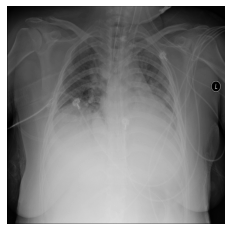

In [ ]:
pylab.imshow(im, cmap = pylab.cm.gist_gray)
pylab.axis('off')

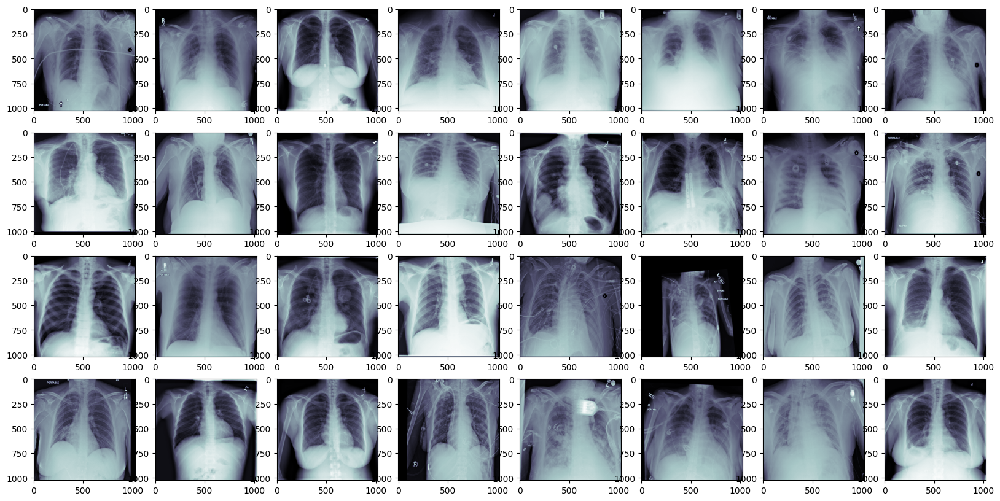

In [ ]:
plt.style.use('default')
fig     = plt.figure(figsize = (20, 10))
columns = 8; rows = 4
for i in range(1, columns*rows +1):
    ds  = pydicom.dcmread(TRAIN_IMAGES_DIR + "/" + TRAIN_IMAGES[i])
    fig.add_subplot(rows, columns, i)
    plt.imshow(ds.pixel_array, cmap=plt.cm.bone)
    fig.add_subplot
fig.savefig('screenshots/samples.png')

#### 1.3.3.1 DICOM Files: Observation Summary

1
2
3

# 2 Explore Data

## 2.1 CSV Files

### 2.1.1 Check Shape: Rows and Column Numbers

In [ ]:
#lets explore our input data to understand better shape of the files

print('SHAPE of "detail_class_info" DataFrame :', detail_class_info.shape)
print('SHAPE of "train_label" DataFrame       :', train_label.shape)
print('SHAPE of "samp_submission" DataFrame   :', samp_submission.shape)

SHAPE of "detail_class_info" DataFrame : (30227, 2)
SHAPE of "train_label" DataFrame       : (30227, 6)
SHAPE of "samp_submission" DataFrame   : (3000, 2)


In [ ]:
print("Number of unique patients in \"detail_class_info\" DataFrame  :", detail_class_info['patientId'].nunique())   
print("Number of unique patients in \"train_label\" DataFrame        :", train_label['patientId'].nunique())  

Number of unique patients in "detail_class_info" DataFrame  : 26684
Number of unique patients in "train_label" DataFrame        : 26684


### 2.1.2 Check Observation Classes & Thier Counts

In [ ]:
print("Number of observation classes in dataset: %i" %  len(detail_class_info["class"].unique()))
print("Classes names are                       : %s" % detail_class_info["class"].unique())

Number of observation classes in dataset: 3
Classes names are                       : ['No Lung Opacity / Not Normal' 'Normal' 'Lung Opacity']


In [ ]:
#number of patient ID loaded under various class
detail_class_info['class'].value_counts()

No Lung Opacity / Not Normal    11821
Lung Opacity                     9555
Normal                           8851
Name: class, dtype: int64

In [ ]:
#percentage of patient ID loaded under various class
detail_class_info['class'].value_counts(normalize = True).round(4)*100

No Lung Opacity / Not Normal    39.11
Lung Opacity                    31.61
Normal                          29.28
Name: class, dtype: float64

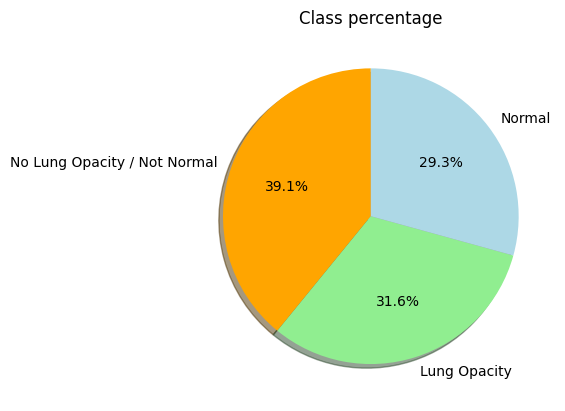

<Figure size 640x480 with 0 Axes>

In [ ]:
class_info = detail_class_info["class"].value_counts()

labels   = (np.array(class_info.index))
sizes    = (np.array((class_info / class_info.sum())*100))
colors   = ['orange', 'lightgreen','lightblue']

plt.pie(sizes, 
        labels = labels, 
        colors = colors,
        autopct = '%1.1f%%', 
        shadow=True, 
        startangle=90)
plt.title("Class percentage")
plt.show()
plt.savefig("screenshots/diagnosisDistribution.png")

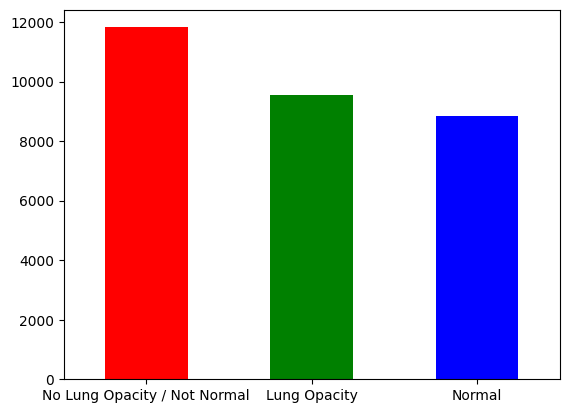

In [ ]:
#visualize the split in class based on Detail Class Information
detail_class_info['class'].value_counts().plot.bar(rot = 0,color = ['red','green','blue'])
plt.savefig("screenshots/diagnosisDistribution1.png")

### 2.1.3 Check Diagnosis Status & Their Counts

In [ ]:
print("Number of patient statuses in dataset : %i" %  len(train_label["Target"].unique()))
print("Status values are                     : %s" % train_label["Target"].unique())

Number of unique patients in dataset  : 26684
Number of patient statuses in dataset : 2
Status values are                     : [0 1]


In [ ]:
#number of patient's with various target values
train_label['Target'].value_counts()

0    20672
1     9555
Name: Target, dtype: int64

In [ ]:
#percentage of patient's with various target values
train_label['Target'].value_counts(normalize = True).round(4)*100

0    68.39
1    31.61
Name: Target, dtype: float64

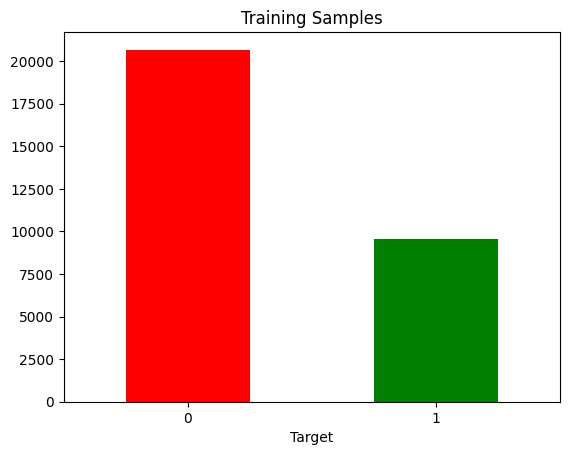

In [ ]:
#visualize the split of patients by STATUS in train labels
plot = train_label.groupby('Target').patientId.count().plot.bar(rot = 0,color = ['red','green','blue'])
fig = plot.set_title("Training Samples").get_figure()
fig.savefig("screenshots/Trainingsamples.png")

### 2.1.4 Check Missing Values

In [ ]:
#Check for missing values, if any
print("Number of missing values in 'details class info' file : ",pd.isnull(detail_class_info).sum().sum())
print("Number of missing values in 'train label' file        : ",pd.isnull(train_label).sum().sum())

Number of missing values in 'details class info' file :  0
Number of missing values in 'train label' file        :  82688


In [ ]:
def missing_data(data):
    total = data.isnull().sum().sort_values(ascending = False)
    percent = (data.isnull().sum()/data.isnull().count()*100).sort_values(ascending = False)
    return np.transpose(pd.concat([total, percent], axis=1, keys=['Total', 'Percent']))

In [ ]:
#Check for missing values, if any in Detailed Class Info
missing_data(detail_class_info)

,class,patientId
Total,0.0,0.0
Percent,0.0,0.0


In [ ]:
#Check for missing values, if any in Training Labels Info
missing_data(train_label)

,height,width,y,x,Target,patientId
Total,20672.000000,20672.000000,20672.000000,20672.000000,0.0,0.0
Percent,68.389188,68.389188,68.389188,68.389188,0.0,0.0


## 2.2 Merged Dataset: Observations and Diagnosis

### 2.2.1 Merging

In [ ]:
train_label_merged = train_label.merge(detail_class_info, on = 'patientId', how = 'inner')

### 2.2.2 Check and Drop Duplicates

In [ ]:
dups = train_label_merged.duplicated()
train_label_merged.drop_duplicates(inplace=True)
train_label_merged.reset_index(drop = True)
train_label_merged.head(10)

,patientId,x,y,width,height,Target,class
0,0004cfab-14fd-4e49-80ba-63a80b6bddd6,NaN,NaN,NaN,NaN,0,No Lung Opacity / Not Normal
1,00313ee0-9eaa-42f4-b0ab-c148ed3241cd,NaN,NaN,NaN,NaN,0,No Lung Opacity / Not Normal
2,00322d4d-1c29-4943-afc9-b6754be640eb,NaN,NaN,NaN,NaN,0,No Lung Opacity / Not Normal
3,003d8fa0-6bf1-40ed-b54c-ac657f8495c5,NaN,NaN,NaN,NaN,0,Normal
4,00436515-870c-4b36-a041-de91049b9ab4,264.0,152.0,213.0,379.0,1,Lung Opacity
6,00436515-870c-4b36-a041-de91049b9ab4,562.0,152.0,256.0,453.0,1,Lung Opacity
8,00569f44-917d-4c86-a842-81832af98c30,NaN,NaN,NaN,NaN,0,No Lung Opacity / Not Normal
9,006cec2e-6ce2-4549-bffa-eadfcd1e9970,NaN,NaN,NaN,NaN,0,No Lung Opacity / Not Normal
10,00704310-78a8-4b38-8475-49f4573b2dbb,323.0,577.0,160.0,104.0,1,Lung Opacity
12,00704310-78a8-4b38-8475-49f4573b2dbb,695.0,575.0,162.0,137.0,1,Lung Opacity


### 2.2.3 Tally Observations and Dianosis Numbers

In [ ]:
tmp = train_label_merged.groupby('Target')['class'].value_counts()
df = pd.DataFrame(data = {'Exams': tmp.values}, index=tmp.index).reset_index()
df.head()

,Target,class,Exams
0,0,No Lung Opacity / Not Normal,11821
1,0,Normal,8851
2,1,Lung Opacity,9555


In [ ]:
train_label_merged.shape

(30227, 7)

### 2.2.4 Check Instances where Multiple CXRs per Patient

In [ ]:
tmp = train_label_merged.groupby(['patientId','Target', 'class'])['patientId'].count()
df = pd.DataFrame(data={'TotalCXRs': tmp.values}, index=tmp.index).reset_index()
tmp = df.groupby(['TotalCXRs','Target','class']).count()
df2 = pd.DataFrame(data=tmp.values, index=tmp.index).reset_index()
df2.columns = ['TotalCXRs', 'Diagnosis','Observation', 'Instances']
df2

,TotalCXRs,Diagnosis,Observation,Instances
0,1,0,No Lung Opacity / Not Normal,11821
1,1,0,Normal,8851
2,1,1,Lung Opacity,2614
3,2,1,Lung Opacity,3266
4,3,1,Lung Opacity,119
5,4,1,Lung Opacity,13


In [ ]:
fig, ax = plt.subplots(nrows=1,figsize=(8,4))

sns.barplot(ax = ax, x = 'Target', y = 'Exams', hue = 'class', data = df, palette = 'Set3')
plt.title("Chest exams Observation and Diagnosis")
plt.xtitle("Diagnosis")
plt.xtitle("Observation Count")
plt.show()

### 2.2.5 Check Distribution of Bounding Boxes

<Figure size 432x288 with 0 Axes>

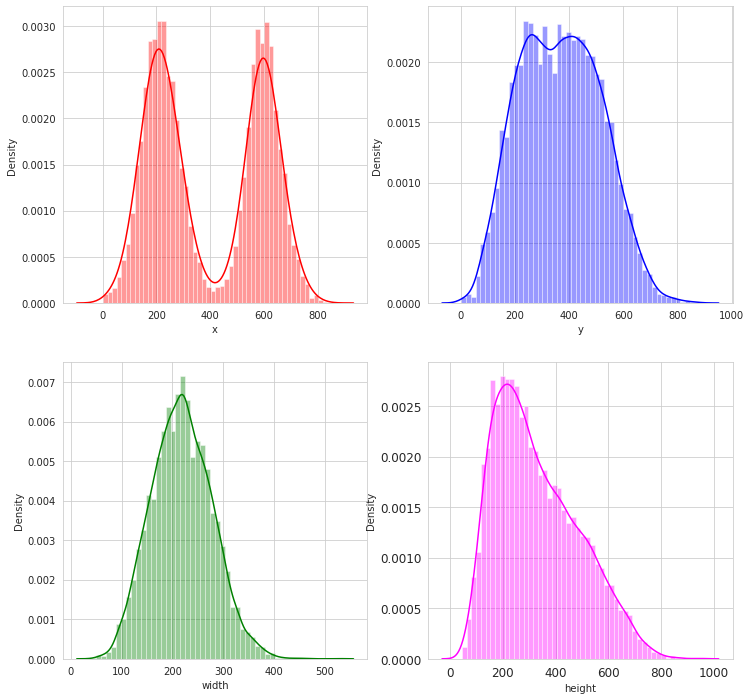

In [ ]:
infected = train_label_merged[train_label_merged['Target'] == 1]
sns.set_style('whitegrid')
plt.figure()

fig, ax = plt.subplots(2, 2, figsize = (12, 12))
sns.distplot(infected['x'], kde = True, bins = 50, color = "red", ax = ax[0, 0])
sns.distplot(infected['y'], kde = True, bins = 50, color = "blue", ax = ax[0, 1])
sns.distplot(infected['width'], kde = True, bins = 50, color = "green", ax = ax[1, 0])
sns.distplot(infected['height'], kde = True, bins = 50, color = "magenta", ax = ax[1, 1])

locs, labels = plt.xticks()
plt.tick_params(axis = 'both', which = 'major', labelsize = 12)
plt.show()

### 2.2.6 Plot Centers of Bounding Boxes

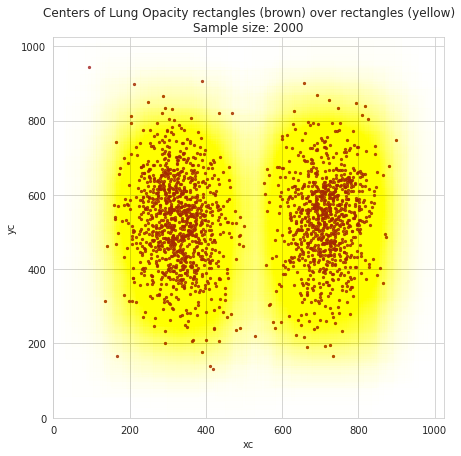

In [ ]:
from matplotlib.patches import Rectangle

fig, ax = plt.subplots(1,1,figsize=(7,7))
target_sample = infected.sample(2000)
target_sample['xc'] = target_sample['x'] + target_sample['width'] / 2
target_sample['yc'] = target_sample['y'] + target_sample['height'] / 2
plt.title("Centers of Lung Opacity rectangles (brown) over rectangles (yellow)\nSample size: 2000")
target_sample.plot.scatter(x = 'xc', 
                           y = 'yc', 
                           xlim = (0,1024), 
                           ylim = (0,1024), 
                           ax = ax, 
                           alpha = 0.8, 
                           marker = ".", 
                           color = "brown")

for i, crt_sample in target_sample.iterrows():
    ax.add_patch(Rectangle(xy = (crt_sample['x'], crt_sample['y']),
                           width = crt_sample['width'],
                           height = crt_sample['height'],
                           alpha = 3.5e-3, 
                           color = "yellow"))
plt.show()

Any given patient may potentially have many boxes if there are several different suspicious areas of pneumonia. To collapse the current CSV file dataframe into a dictionary with unique entries, we will consider the following method:

## 2.3 DICOM Files

### 2.3.1 Check Number of Images

In [ ]:
training_images = os.listdir('stage_2_train_images')
testing_images  = os.listdir('stage_2_test_images')

In [ ]:
print("Number of images in train set  :", len(training_images))
print("Number of images in test set   :", len(testing_images))

Number of images in train set  : 26684
Number of images in test set   : 3000


### 2.3.2 Draw DICOM Image With Bounding Boxes

In [ ]:
#method to draw single patient with bounding box(es) if present 
def draw(data):
    # --- Open DICOM file
    d  = pydicom.read_file(data['dicom'])
    im = d.pixel_array

    # --- Convert from single-channel grayscale to 3-channel RGB
    im = np.stack([im] * 3, axis = 2)

    # --- Add boxes with random color if present
    for box in data['boxes']:
        rgb = np.floor(np.random.rand(3) * 256).astype('int')
        im  = overlay_box(im = im, box = box, rgb = rgb, stroke = 6)

    pylab.imshow(im, cmap = pylab.cm.gist_gray)
    pylab.axis('off')

#method to overlay single box on image
def overlay_box(im, box, rgb, stroke = 1):
    # --- Convert coordinates to integers
    box = [int(b) for b in box]
    
    # --- Extract coordinates
    y1, x1, height, width = box
    y2 = y1 + height
    x2 = x1 + width

    im[y1:y1 + stroke, x1:x2] = rgb
    im[y2:y2 + stroke, x1:x2] = rgb
    im[y1:y2, x1:x1 + stroke] = rgb
    im[y1:y2, x2:x2 + stroke] = rgb

    return im

In [ ]:
def parse_data(df):
    """
    Method to read a CSV file (Pandas dataframe) and parse the 
    data into the following nested dictionary:

      parsed = {
        
        'patientId-00': {
            'dicom': path/to/dicom/file,
            'label': either 0 or 1 for normal or pnuemonia, 
            'boxes': list of box(es)
        },
        'patientId-01': {
            'dicom': path/to/dicom/file,
            'label': either 0 or 1 for normal or pnuemonia, 
            'boxes': list of box(es)
        }, ...

      }

    """
    # --- Define lambda to extract coords in list [y, x, height, width]
    extract_box = lambda row: [row['y'], row['x'], row['height'], row['width']]

    parsed = {}
    for n, row in df.iterrows():
        # --- Initialize patient entry into parsed 
        pid = row['patientId']
        if pid not in parsed:
            parsed[pid] = {
                'dicom': 'stage_2_train_images/%s.dcm' % pid,
                'label': row['Target'],
                'boxes': []}

        # --- Add box if opacity is present
        if parsed[pid]['label'] == 1:
            parsed[pid]['boxes'].append(extract_box(row))

    return parsed

In [ ]:
parsed = parse_data(train_label_merged)

In [ ]:
print(parsed['00436515-870c-4b36-a041-de91049b9ab4'])

{'dicom': 'stage_2_train_images/00436515-870c-4b36-a041-de91049b9ab4.dcm', 'label': 1, 'boxes': [[152.0, 264.0, 379.0, 213.0], [152.0, 562.0, 453.0, 256.0]]}


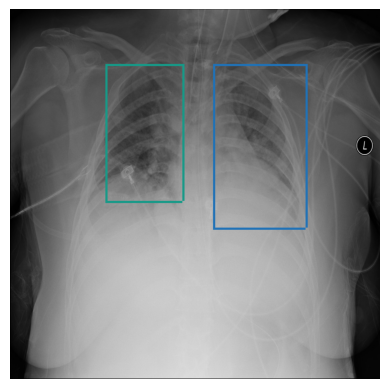

In [ ]:
draw(parsed['00436515-870c-4b36-a041-de91049b9ab4'])

### 2.3.3 Draw DICOM Images With Selective Metadata

In [ ]:
def show_dicom_images(data):
    img_data = list(data.T.to_dict().values())
    f, ax = plt.subplots(3,3, figsize=(16,18))
    for i,data_row in enumerate(img_data):
        patientImage = data_row['patientId']+'.dcm'
        imagePath = os.path.join("stage_2_train_images/",patientImage)
        data_row_img_data = dcm.read_file(imagePath)
        modality = data_row_img_data.Modality
        age = data_row_img_data.PatientAge
        sex = data_row_img_data.PatientSex
        data_row_img = dcm.dcmread(imagePath)
        ax[i//3, i%3].imshow(data_row_img.pixel_array, cmap=plt.cm.bone) 
        ax[i//3, i%3].axis('off')
        ax[i//3, i%3].set_title('ID: {}\nModality: {} Age: {} Sex: {} Target: {}\nClass: {}\nWindow: {}:{}:{}:{}'.format(
                data_row['patientId'],
                modality, age, sex, data_row['Target'], data_row['class'], 
                data_row['x'],data_row['y'],data_row['width'],data_row['height']))
    plt.show()

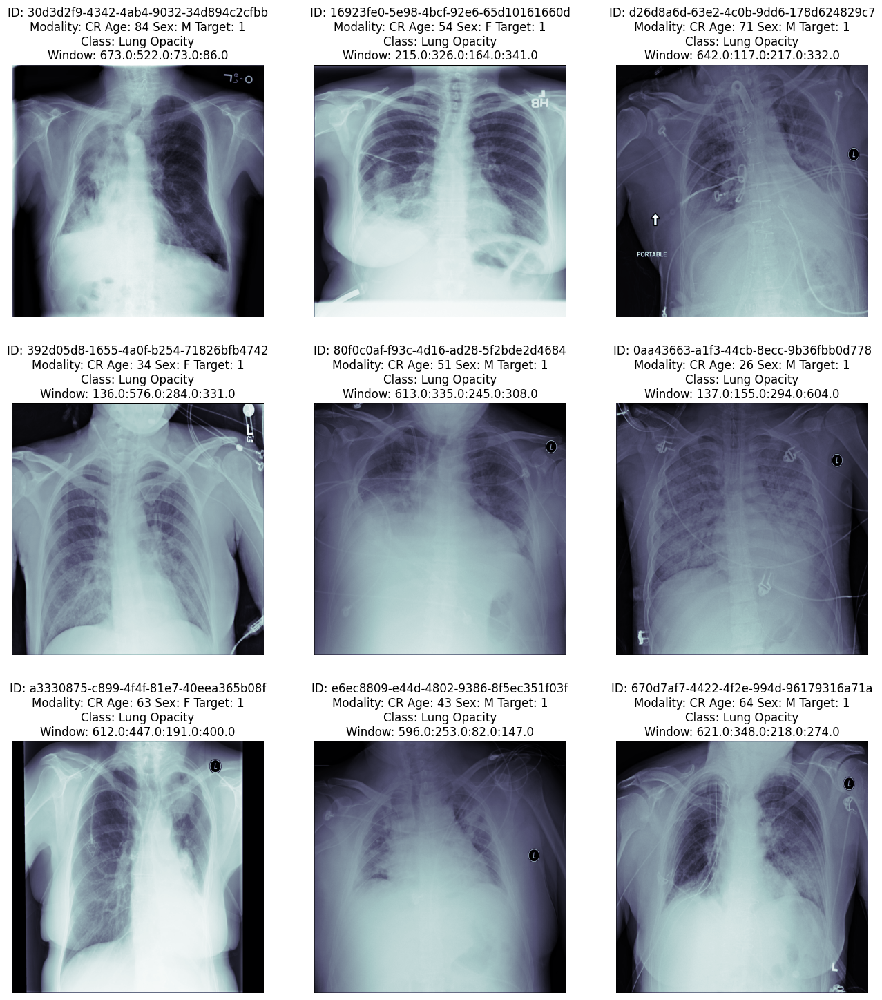

In [ ]:
show_dicom_images(train_label_merged[train_label_merged['Target']==1].sample(9))

### 2.3.4 Draw DICOM Images By Observation Type

In [ ]:
opacity    = train_label_merged.loc[train_label_merged['class'] == 'Lung Opacity'].reset_index()
not_normal = train_label_merged.loc[train_label_merged['class'] == 'No Lung Opacity / Not Normal'].reset_index()
normal     = train_label_merged.loc[train_label_merged['class'] == 'Normal'].reset_index()

#### 2.3.4.1 Observation: Has OPACITY

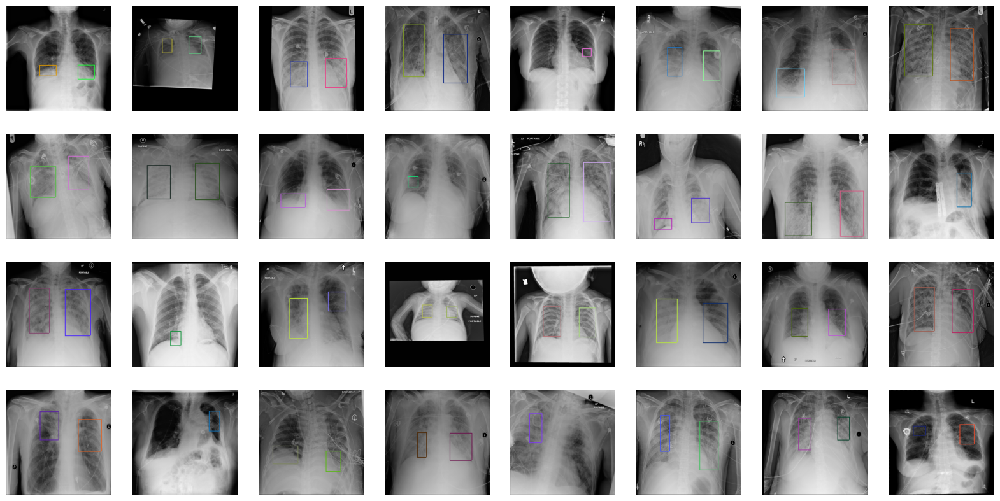

In [ ]:
plt.style.use('default')
fig=plt.figure(figsize=(20, 10))
columns = 8; rows = 4
for i in range(1, columns*rows +1):
    fig.add_subplot(rows, columns, i)
    draw(parsed[opacity['patientId'].unique()[i]])

#### 2.3.4.2 Observation: NOT NORMAL

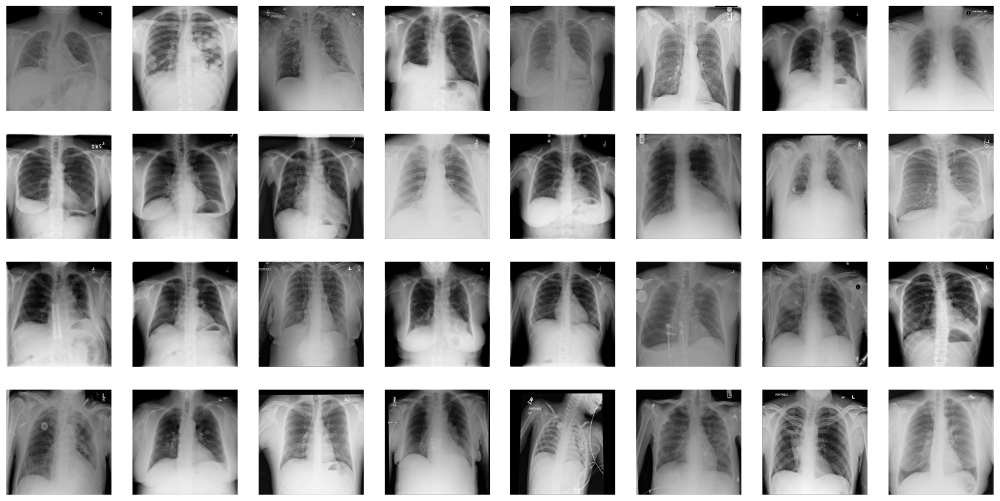

In [ ]:
plt.style.use('default')
fig=plt.figure(figsize=(20, 10))
columns = 8; rows = 4
for i in range(1, columns*rows +1):
    fig.add_subplot(rows, columns, i)
    draw(parsed[not_normal['patientId'].loc[i]])

#### 2.3.4.3 Observation: NORMAL

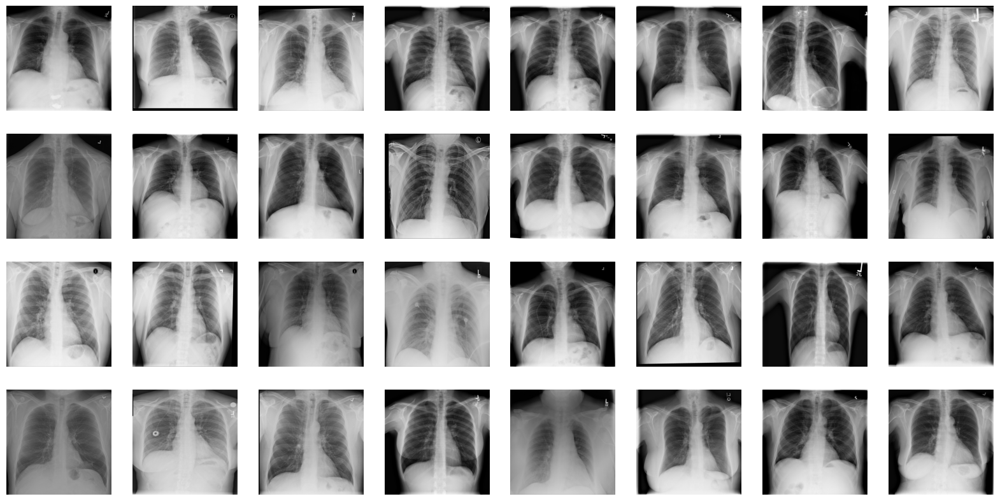

In [ ]:
plt.style.use('default')
fig=plt.figure(figsize=(20, 10))
columns = 8; rows = 4
for i in range(1, columns*rows +1):
    fig.add_subplot(rows, columns, i)
    draw(parsed[normal['patientId'].loc[i]])

#### 2.3.4.4 Observation: All Three Side By Side

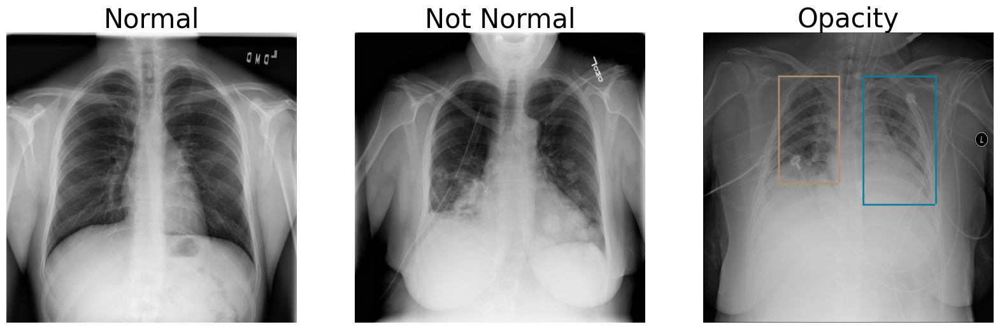

In [ ]:
fig=plt.figure(figsize=(20, 10))
columns = 3; rows = 1
fig.add_subplot(rows, columns, 1).set_title("Normal", fontsize=30)
draw(parsed[normal['patientId'].unique()[0]])
fig.add_subplot(rows, columns, 2).set_title("Not Normal", fontsize=30)
# ax2.set_title("Not Normal", fontsize=30)
draw(parsed[not_normal['patientId'].unique()[0]])
fig.add_subplot(rows, columns, 3).set_title("Opacity", fontsize=30)
# ax3.set_title("Opacity", fontsize=30)
draw(parsed[opacity['patientId'].unique()[0]])

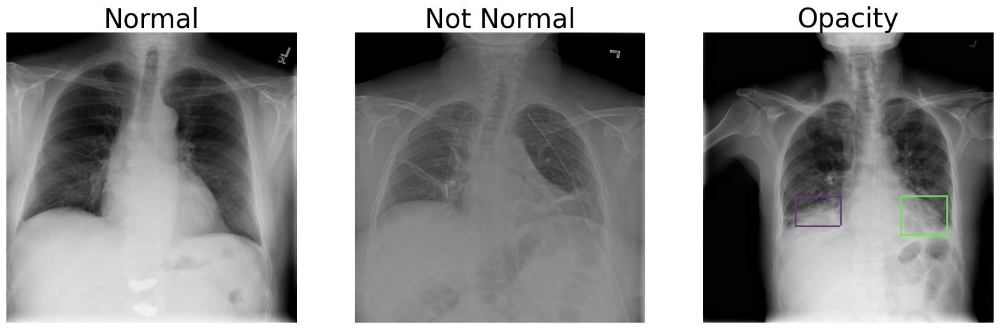

In [ ]:
fig=plt.figure(figsize=(20, 10))
columns = 3; rows = 1
fig.add_subplot(rows, columns, 1).set_title("Normal", fontsize=30)
draw(parsed[normal['patientId'].unique()[1]])
fig.add_subplot(rows, columns, 2).set_title("Not Normal", fontsize=30)
draw(parsed[not_normal['patientId'].unique()[1]])
fig.add_subplot(rows, columns, 3).set_title("Opacity", fontsize=30)
draw(parsed[opacity['patientId'].unique()[1]])

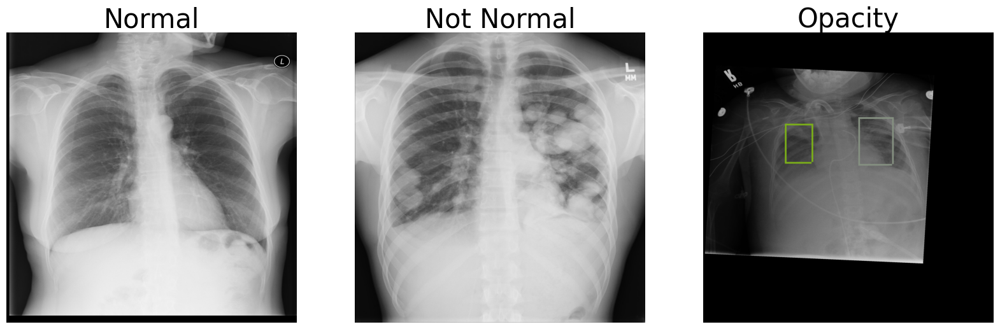

In [ ]:
fig=plt.figure(figsize=(20, 10))
columns = 3; rows = 1
fig.add_subplot(rows, columns, 1).set_title("Normal", fontsize=30)
draw(parsed[normal['patientId'].unique()[2]])
fig.add_subplot(rows, columns, 2).set_title("Not Normal", fontsize=30)
draw(parsed[not_normal['patientId'].unique()[2]])
fig.add_subplot(rows, columns, 3).set_title("Opacity", fontsize=30)
draw(parsed[opacity['patientId'].unique()[2]])

In [ ]:
image_sample_path = os.listdir('stage_2_train_images')[:5]
print(image_sample_path)

['c9299322-1d78-4d83-8f7c-45487ff01cc2.dcm', '0ca9d557-c26c-4dfc-84cc-aac7254ceeb1.dcm', '37f70057-7e01-4aae-8940-6712bfe34255.dcm', 'f060ad29-440c-4662-ad71-e69516a3c42e.dcm', '9f00ee9d-2d51-4ff2-845c-583904f36fd1.dcm']


In [ ]:
samplePatientID = list(train_label_merged[:3].T.to_dict().values())[0]['patientId']
samplePatientID = samplePatientID+'.dcm'
dicom_file_path = os.path.join("stage_2_train_images/",samplePatientID)
dicom_file_dataset = dcm.read_file(dicom_file_path)
dicom_file_dataset

Dataset.file_meta -------------------------------
(0002, 0000) File Meta Information Group Length  UL: 202
(0002, 0001) File Meta Information Version       OB: b'\x00\x01'
(0002, 0002) Media Storage SOP Class UID         UI: Secondary Capture Image Storage
(0002, 0003) Media Storage SOP Instance UID      UI: 1.2.276.0.7230010.3.1.4.8323329.28530.1517874485.775526
(0002, 0010) Transfer Syntax UID                 UI: JPEG Baseline (Process 1)
(0002, 0012) Implementation Class UID            UI: 1.2.276.0.7230010.3.0.3.6.0
(0002, 0013) Implementation Version Name         SH: 'OFFIS_DCMTK_360'
-------------------------------------------------
(0008, 0005) Specific Character Set              CS: 'ISO_IR 100'
(0008, 0016) SOP Class UID                       UI: Secondary Capture Image Storage
(0008, 0018) SOP Instance UID                    UI: 1.2.276.0.7230010.3.1.4.8323329.28530.1517874485.775526
(0008, 0020) Study Date                          DA: '19010101'
(0008, 0030) Study Time      

In [ ]:
def formatMetadataString(val):
    return str(val).split(':')[1].replace('\'', '')

In [ ]:
image_data       = []

dataDir          = ROOT_DIR
trainimg_folder  ='stage_2_train_images'
testing_folder   ='stage_2_test_images'

trainfiles       = glob.glob(os.path.join(dataDir,trainimg_folder, "*.dcm"))

for f in trainfiles:    
    patientId    = formatMetadataString(dcm_data['PatientID'])
    age          = formatMetadataString(dcm_data['PatientAge'])
    gender       = formatMetadataString(dcm_data['PatientSex'])
    viewPos      = formatMetadataString(dcm_data['ViewPosition'])    

    image_data.append([patientId, int(age), gender, viewPos])

In [ ]:
patientIds = train_label_merged.drop_duplicates('patientId', keep = 'first').patientId.tolist()

In [ ]:
Sex = []
Age = []
for patientId in patientIds:
    dcm_file = 'stage_2_train_images/%s.dcm' % patientId
    dcm_data = pydicom.read_file(dcm_file)
    Sex.append(dcm_data.PatientSex)
    Age.append(int(dcm_data.PatientAge))

In [ ]:
patientInfo = pd.DataFrame({'patientId': patientIds, 'patientSex': Sex, 'patientAge': Age})
patientInfo.dtypes

patientId     object
patientSex    object
patientAge     int64
dtype: object

In [ ]:
patientAge_count = patientInfo['patientAge'].value_counts().sum()
patientSex_count = patientInfo['patientSex'].value_counts().sum()
patient_count = patientInfo['patientId'].value_counts().sum()

print("total number of patientId :: %i" % patient_count )
print("Total number of patients with Non null patientSex :: %i " % patientSex_count )
print("Total number of patients with Non null patientAge :: %i " %  patientAge_count )
print("Number of missing values to be imputed for the first field :: %i " % (patient_count - patientSex_count) )
print("Number of missing values to be imputed for the second field :: %i " % (patient_count - patientAge_count) )

total number of patientId :: 26684
Total number of patients with Non null patientSex :: 26684 
Total number of patients with Non null patientAge :: 26684 
Number of missing values to be imputed for the first field :: 0 
Number of missing values to be imputed for the second field :: 0 


In [ ]:
patientInfo = patientInfo.set_index('patientId').join(train_label_merged.set_index('patientId'))[['patientSex', 'patientAge', 'Target']]
patientInfo.reset_index(inplace=True)
patientInfo.head()

,patientId,patientSex,patientAge,Target
0,0004cfab-14fd-4e49-80ba-63a80b6bddd6,F,51,0
1,000924cf-0f8d-42bd-9158-1af53881a557,F,19,0
2,000db696-cf54-4385-b10b-6b16fbb3f985,F,25,1
3,000db696-cf54-4385-b10b-6b16fbb3f985,F,25,1
4,000fe35a-2649-43d4-b027-e67796d412e0,M,40,1


In [ ]:
patientInfo.describe()

,patientAge,Target
count,30227.000000,30227.000000
mean,46.797764,0.316108
std,16.892940,0.464963
min,1.000000,0.000000
25%,34.000000,0.000000
50%,49.000000,0.000000
75%,59.000000,1.000000
max,155.000000,1.000000


In [ ]:
patientInfo['patientAge'].unique()

array([ 51,  19,  25,  40,  57,  56,  76,  31,  54,  28,  63,  48,  32,
        26,  22,  12,  78,  75,  23,  59,  49,   6,  70,  58,  36,  73,
        43,  60,  21,  72,  52,  55,  53,  16,  71,  77,  50,  39,  69,
        38,  47,  67,  44,  14,  68,  42,  41,  62,  15,  29,   2,  13,
        34,  61,  35,  66,  45,  74,  30,   7,  46,   3,  37,  85,  20,
        27,  64,  17,  33,  24,  65,  18,   9,  87,  10,  86,  79,  83,
        81,  11,  80,   8,   4,  82,  91,   5,  84,  90,  88,  89, 148,
         1,  92, 151, 153, 150, 155])

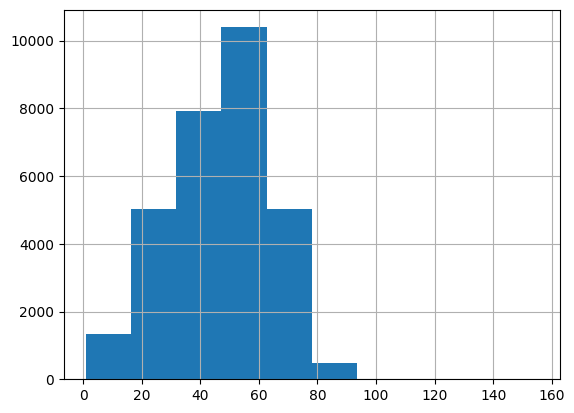

In [ ]:
patientInfo['patientAge'].hist()

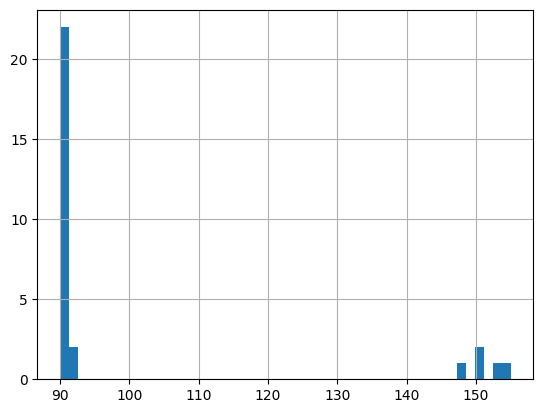

In [ ]:
patientInfo[patientInfo['patientAge']>=90]['patientAge'].hist(bins=50)

In [ ]:
patientInfo[patientInfo['patientAge']>=85]['patientAge'].value_counts()

86     25
87     20
90     19
85     16
88     12
89      8
91      3
92      2
155     1
153     1
151     1
150     1
148     1
Name: patientAge, dtype: int64

In [ ]:
def draw_img(patient_id, title=None):
    dcm_file = 'stage_2_train_images/%s.dcm' % patient_id
    dcm_data = pydicom.read_file(dcm_file)
    plt.imshow(dcm_data.pixel_array)
    if title is not None:
        plt.title(title)

In [ ]:
patients_greater_100 = patientInfo[patientInfo['patientAge']>=100]
patients_less_5 = patientInfo[patientInfo['patientAge']<=5]
patients_mid_age = patientInfo[(patientInfo['patientAge']>=30) & (patientInfo['patientAge']<= 50)]

In [ ]:
def draw_grid(arr_patients, rows=5, columns=4, titles=None, figsize=(15, 15)):
    fig=plt.figure(figsize=figsize)
    for i in range(1, columns*rows + 1):
        if(i <= len(arr_patients)):
            fig.add_subplot(rows, columns, i)
            if titles is None:
                    draw_img(arr_patients[i - 1])
            else:
                    draw_img(arr_patients[i - 1], title=titles[i - 1])
    plt.show()

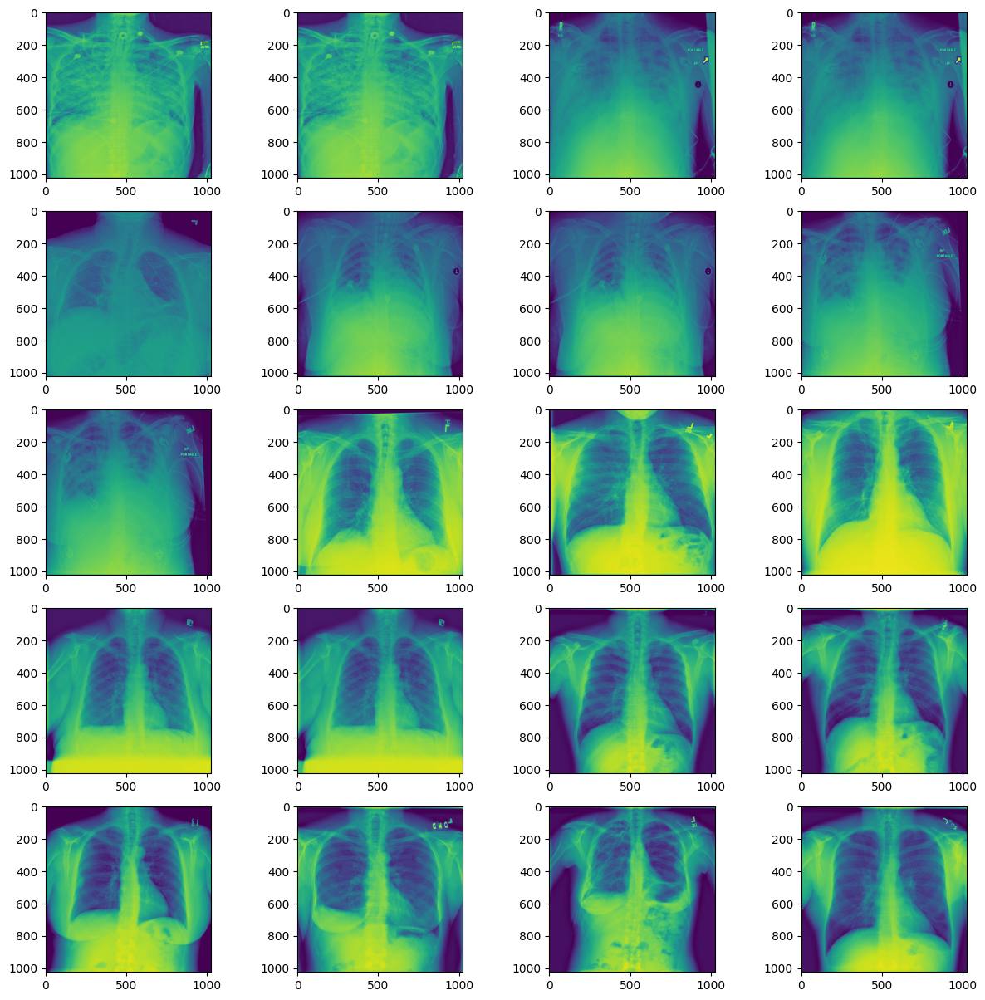

In [ ]:
draw_grid(patients_mid_age['patientId'].tolist())

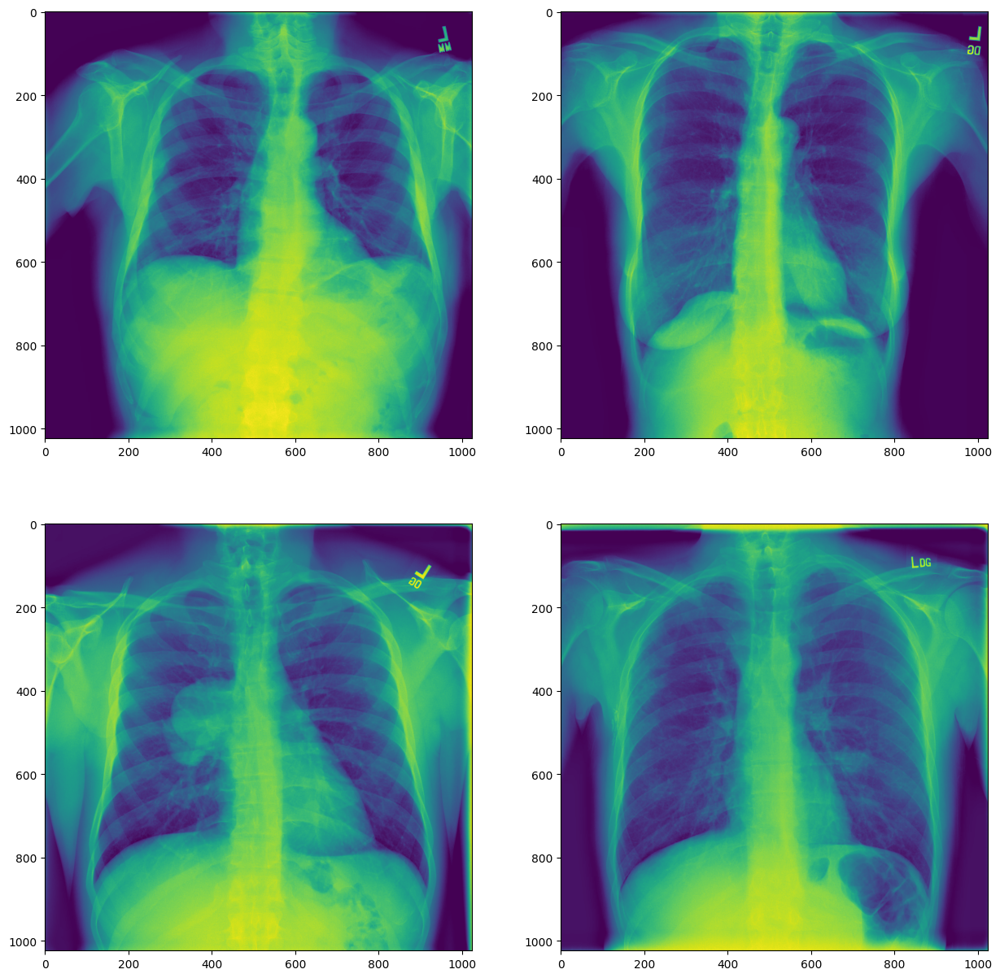

In [ ]:
draw_grid(patients_greater_100['patientId'].tolist(), 2, 2)

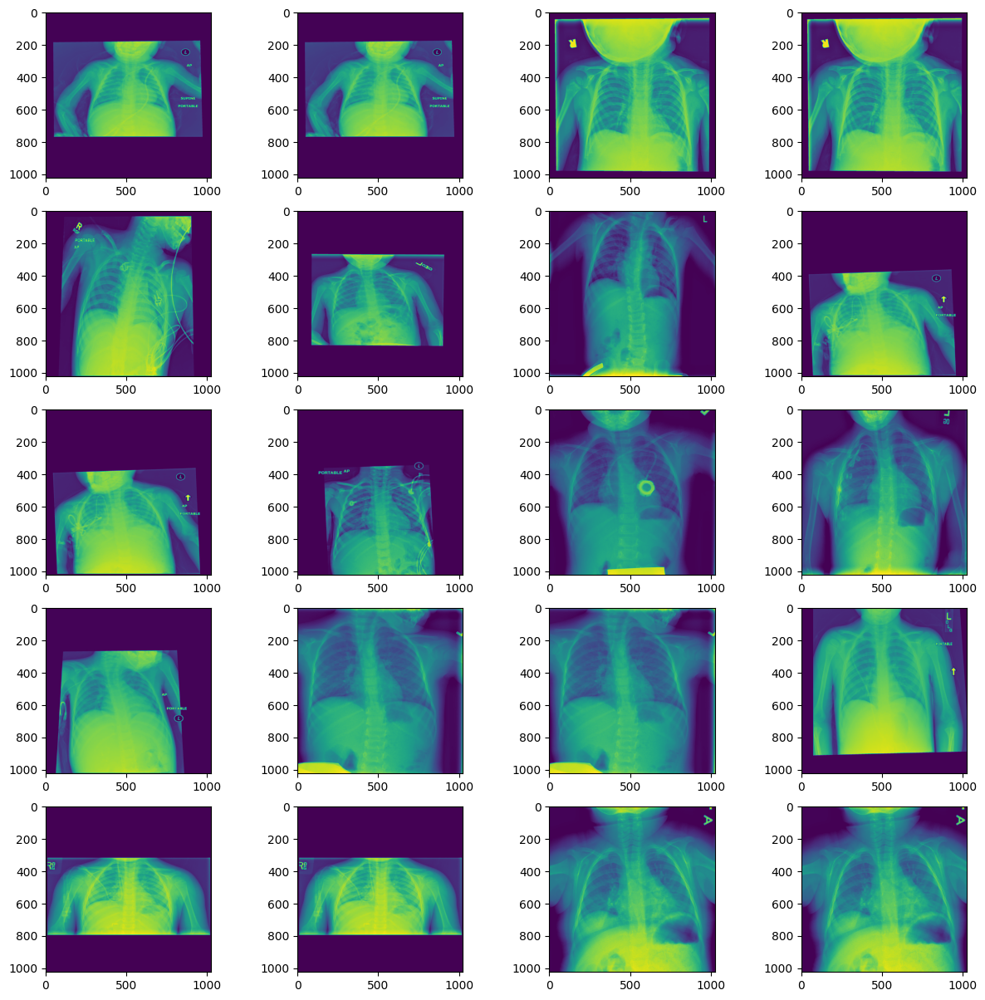

In [ ]:
draw_grid(patients_less_5['patientId'].tolist())

In [ ]:
patientInfo['age_category'] = (patientInfo['patientAge'] // 10) * 10

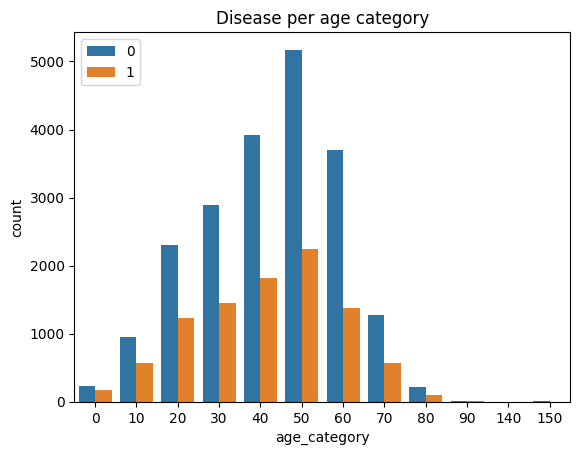

In [ ]:
ax = sns.countplot(x="age_category", hue="Target", data=patientInfo)
ax.set_title('Disease per age category')
ax.legend(title='Disease')
ax.legend()

In [ ]:
patientInfo['patientSex'].value_counts()

M    17216
F    13011
Name: patientSex, dtype: int64

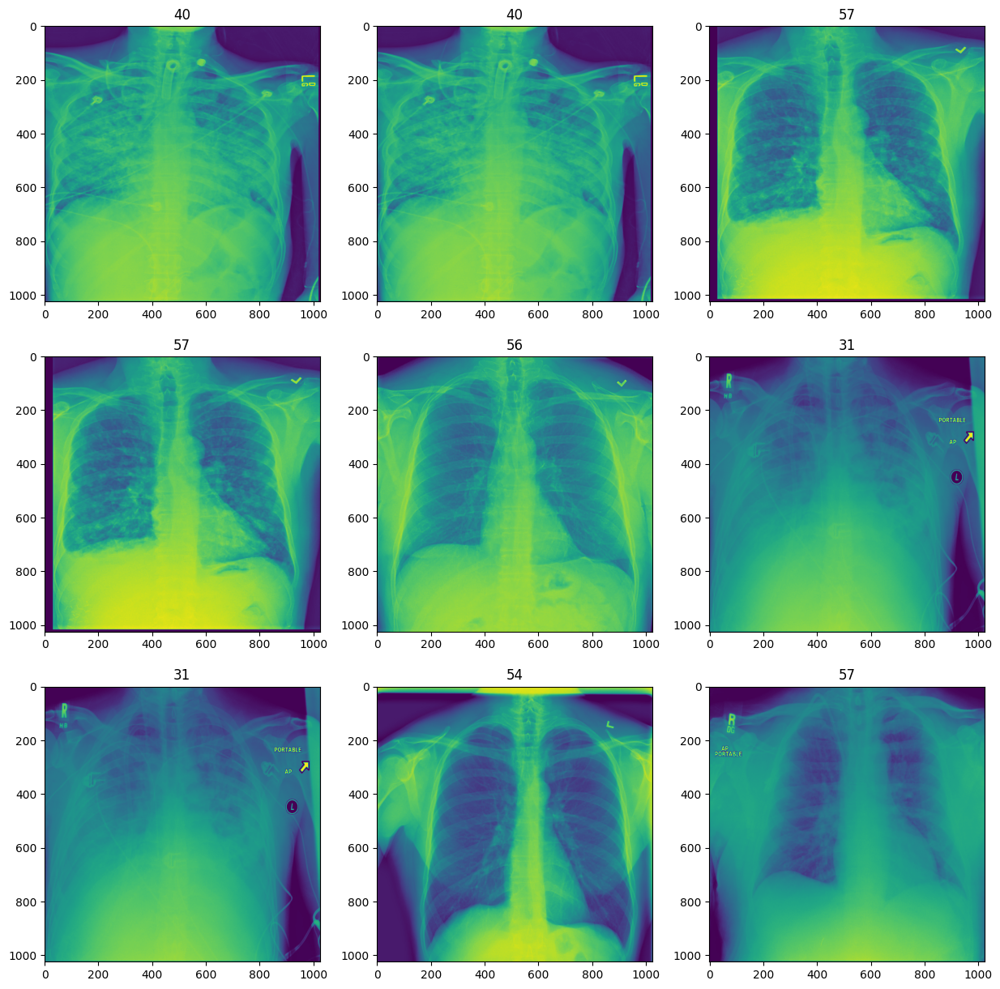

In [ ]:
draw_grid(patientInfo[patientInfo['patientSex'] == 'M']['patientId'].tolist(), 3, 3, 
          titles=patientInfo[patientInfo['patientSex'] == 'M']['patientAge'].tolist(), figsize=(15, 15))

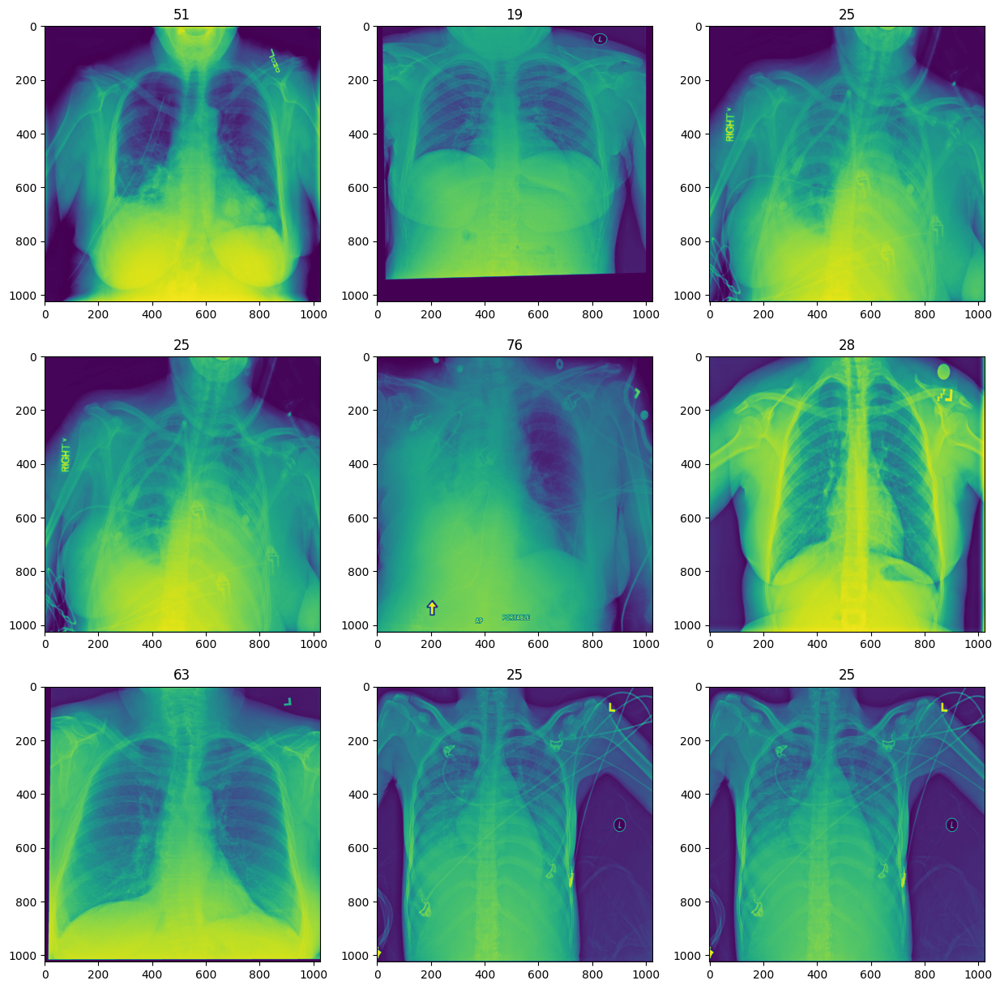

In [ ]:
draw_grid(patientInfo[patientInfo['patientSex'] == 'F']['patientId'].tolist(), 3, 3, 
          titles=patientInfo[patientInfo['patientSex'] == 'F']['patientAge'].tolist(), figsize=(15, 15))

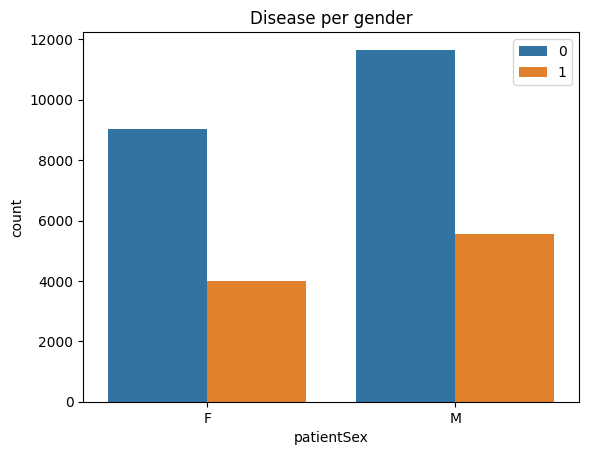

In [ ]:
ax = sns.countplot(x="patientSex", hue="Target", data=patientInfo)
ax.set_title('Disease per gender')
ax.legend(title='Disease')
ax.legend()

In [ ]:
z = {'F': 1, 'M': 0}
patientInfo['Sex'] = patientInfo['patientSex'].map(z)

In [ ]:
corr = patientInfo.corr()
corr

,patientAge,Target,age_category,Sex
patientAge,1.000000,-0.056878,0.985862,0.009842
Target,-0.056878,1.000000,-0.055807,-0.016940
age_category,0.985862,-0.055807,1.000000,0.009361
Sex,0.009842,-0.016940,0.009361,1.000000


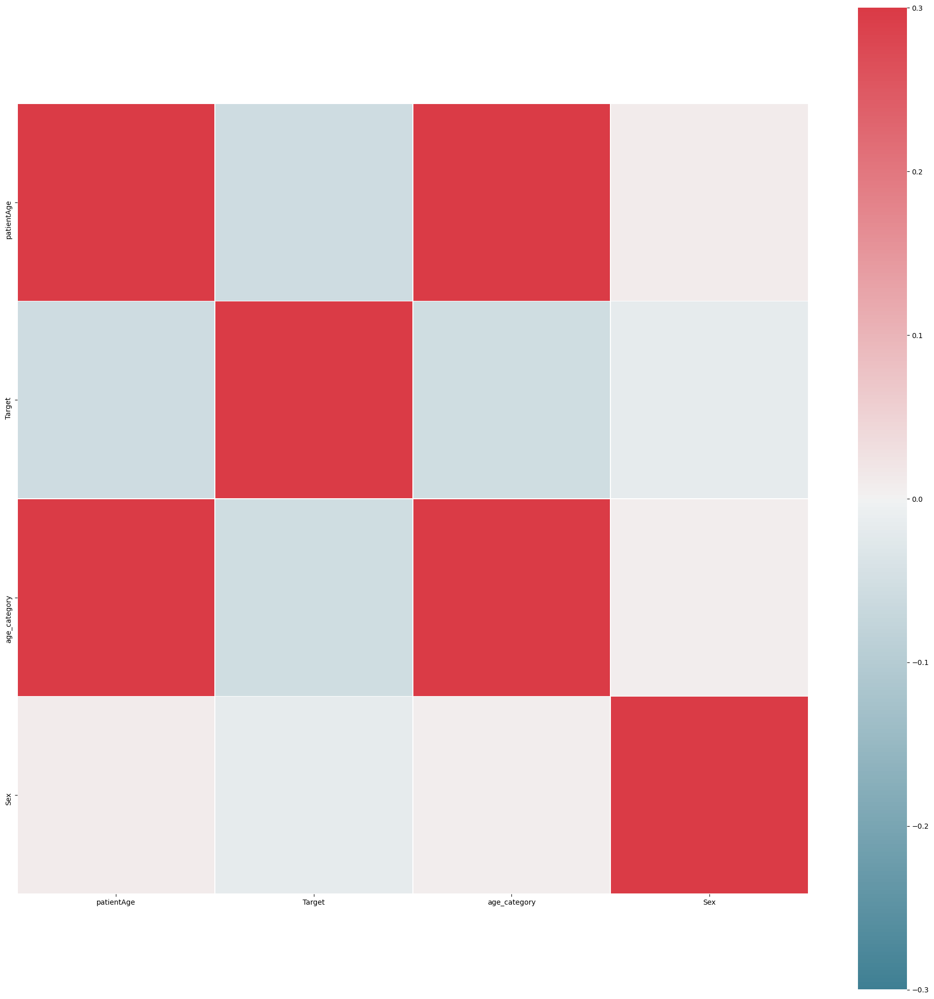

In [ ]:
f, ax = plt.subplots(figsize=(25, 25))
cmap = sns.diverging_palette(220, 10, as_cmap=True)
sns.heatmap(corr, cmap=cmap, vmax= .3,vmin = - 0.3, center=0,
            square=True, linewidths=.5)

In [ ]:
patientId = patientInfo.patientId
tmp_cluster = patientInfo.drop(['patientId', "Target", 'patientSex', 'age_category'], axis = 1)
tmp_cluster['patientAge'].max()

155

In [ ]:
from sklearn.cluster import KMeans

def kmeans(n, tmp_cluster) :
    cluster = KMeans(n_clusters=n, max_iter=300, tol=0.0001, verbose=0, random_state = 0, n_jobs=-1).fit(tmp_cluster)
    return cluster.labels_

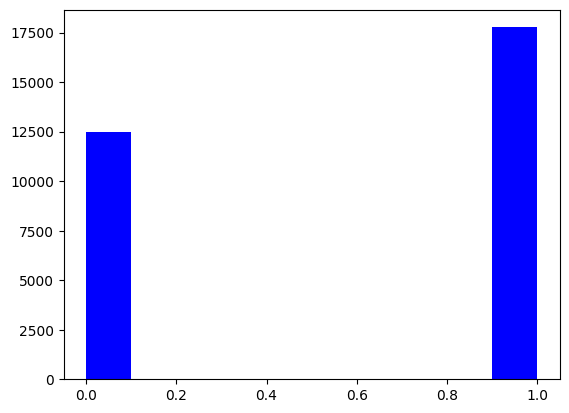

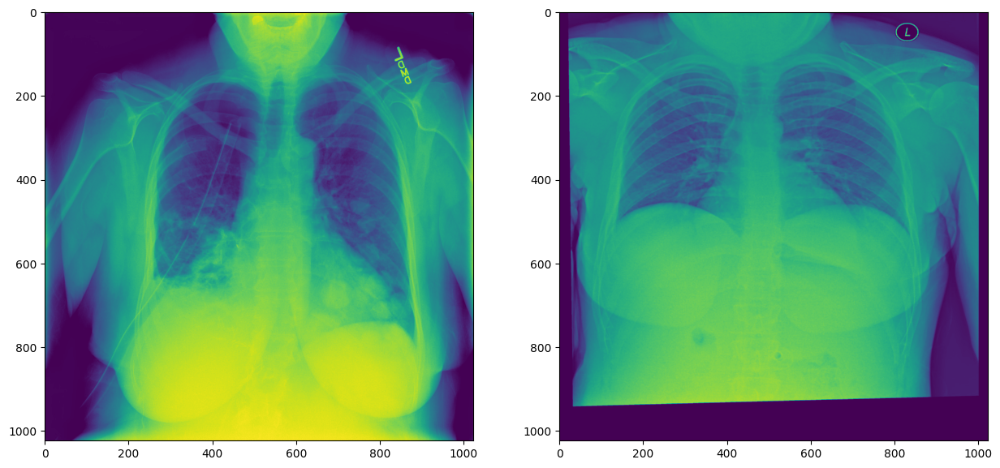

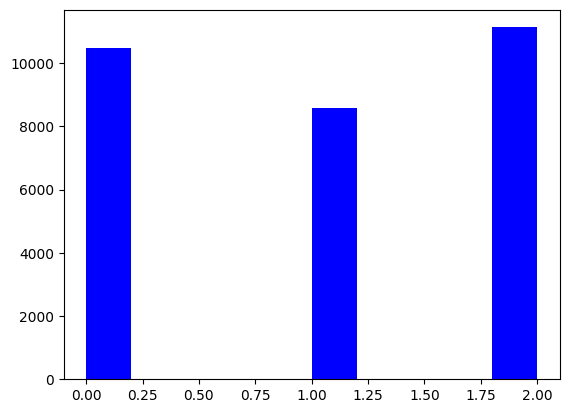

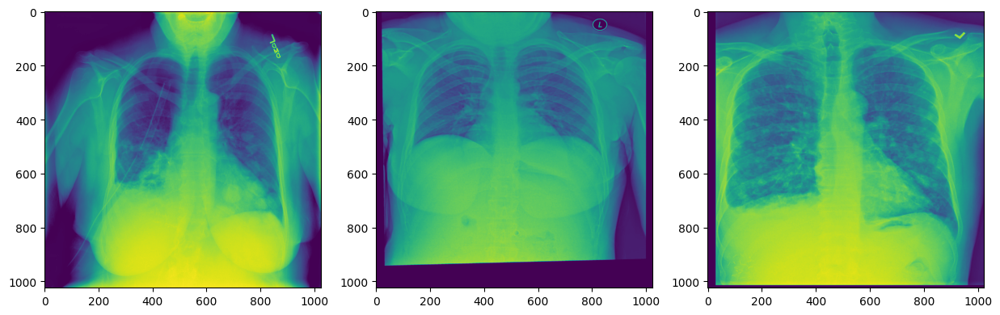

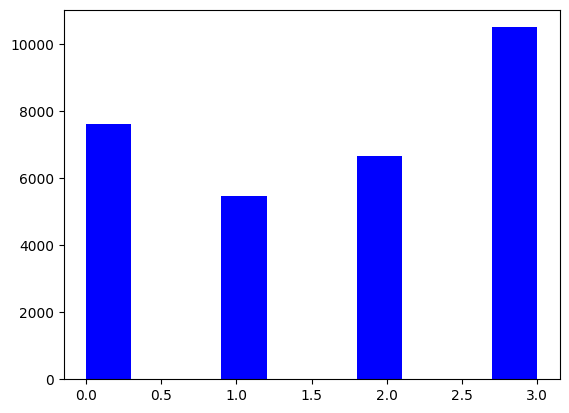

...

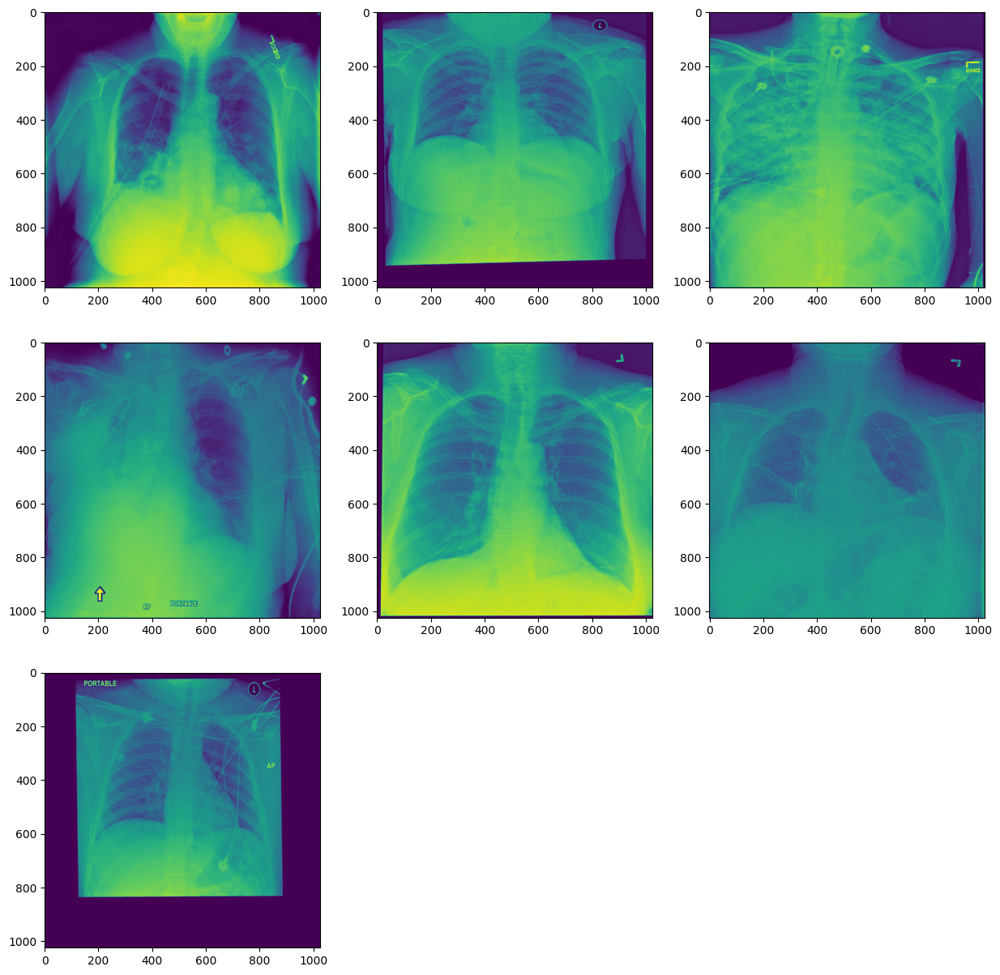

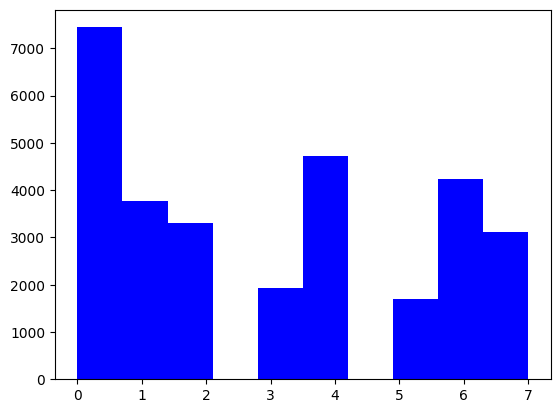

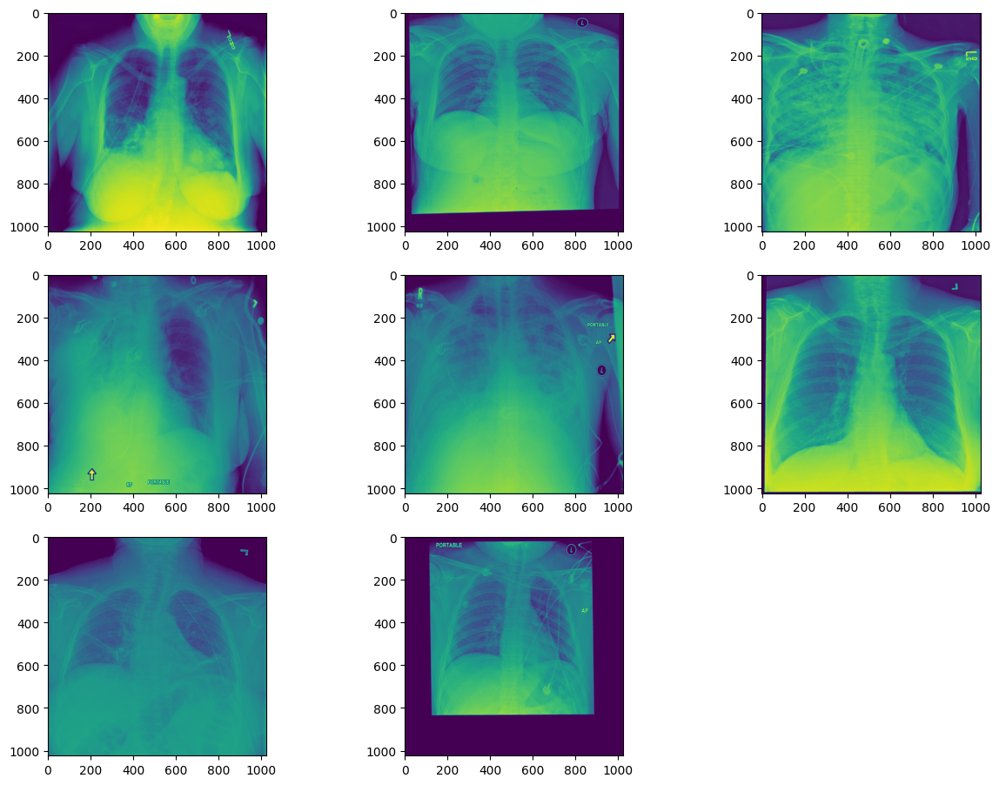

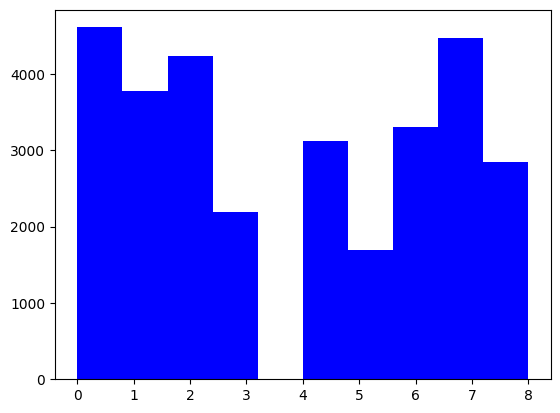

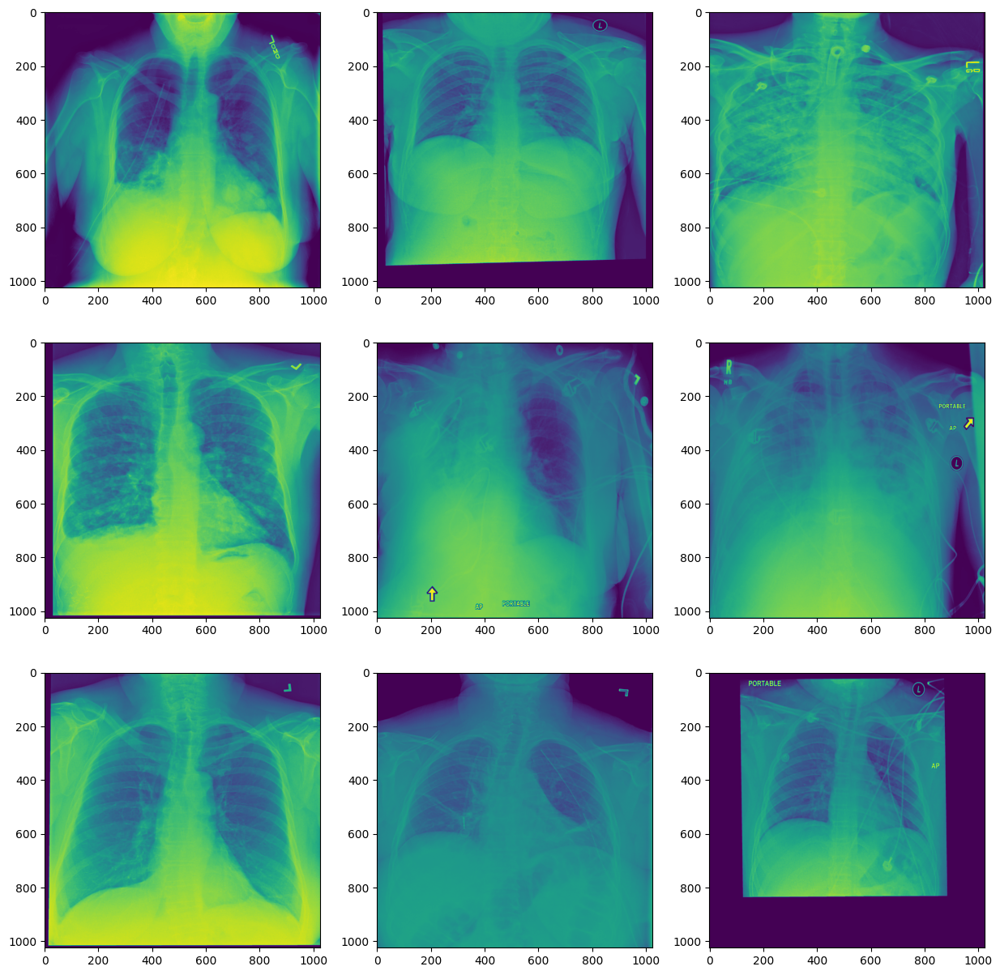

In [ ]:
tmp_cluster_Id = pd.DataFrame()
rows = 0
for i in range(2,10):
    columns = 3
    tmp_cluster["clusters"] = kmeans(i, tmp_cluster)
    n, bins, patches = plt.hist(tmp_cluster["clusters"], facecolor='b')
    tmp_cluster_Id = tmp_cluster.copy()
    tmp_cluster_Id["patientId"] = patientId
    pics = ((tmp_cluster_Id.drop_duplicates('clusters', keep = 'first'))['patientId']).tolist()
    
    if( len( pics ) >= 3) :
        rows = (((len(pics) - 3) / 3) + (len(pics) - 3) % 3) + 1
    else : 
        columns = 2
        rows = 1
    draw_grid(pics, columns = columns, rows = int(rows) )
    plt.show()

In [ ]:
def remove_borders(img_data, threshold = 10):
    img_data = img_data[:, np.max(img_data, axis=0) > threshold]
    img_data = img_data[np.max(img_data, axis=1) > threshold]
    img_data = cv2.resize(img_data, (1024, 1024))
    return img_data

In [ ]:
def read_one_img(patientId):
    dcm_file = 'stage_2_train_images/%s.dcm' % patientId
    dcm_data = pydicom.read_file(dcm_file)
    img = dcm_data.pixel_array
    img = remove_borders(img)
    img = cv2.resize(img, (224, 224))
    return img

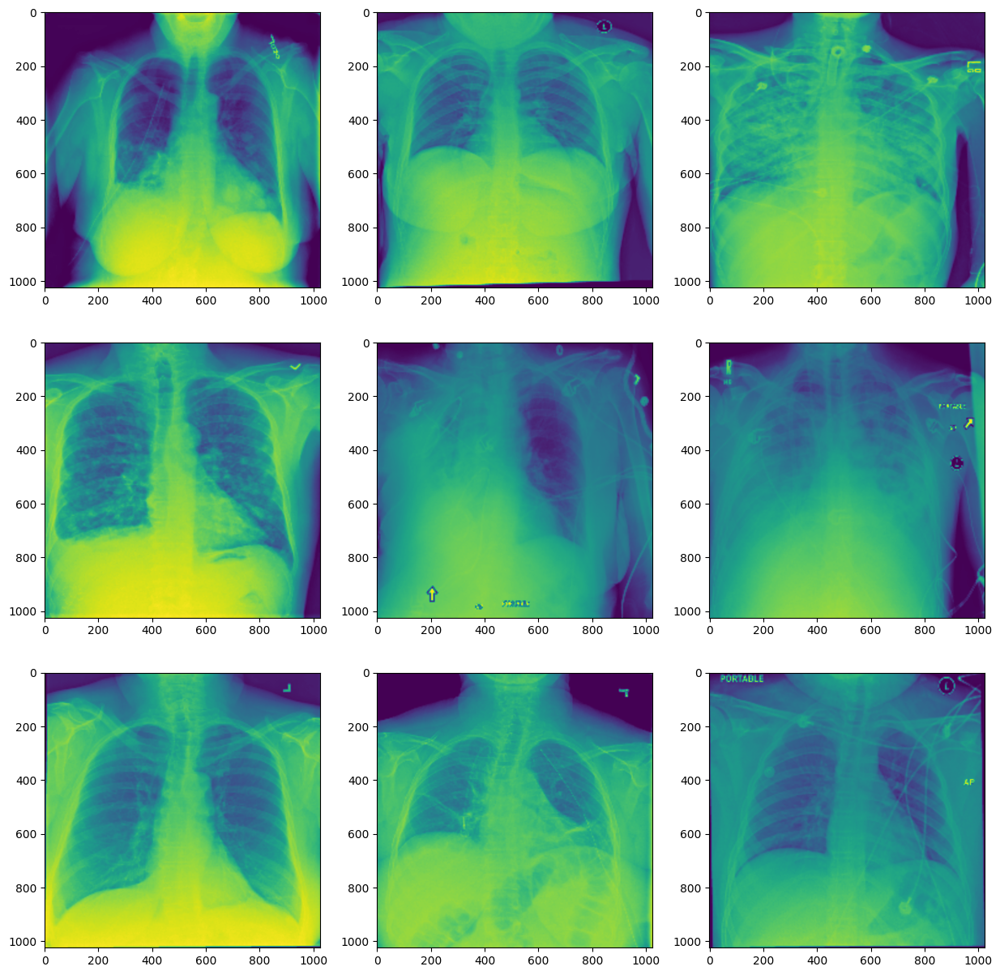

In [ ]:
figure=plt.figure(figsize=(15,15))

for (i, j) in enumerate(pics) :
    image = read_one_img(j)
    image_pixels = remove_borders(image)
    figure.add_subplot(3, 3, i+1)
    plt.imshow(image_pixels)
    
plt.show()